# Synthetic Image Generation Notebook

This notebook guides the process of:

1. Computing how many synthetic images to generate per multi-task label combination.
2. Testing different prompt templates to see which LLM outputs the best captions.
3. Generating images via Stable Diffusion (v1.6 or 3.5) and/or Black Forest AI FLUX.1.
4. Optionally evaluating the quality of the generated images using LLM-based classification checks.

**Cell 1** sets up the environment by importing configurations and performing standard initialisation (paths, seeds, GPU detection, etc.).


In [25]:
from utils import setup_notebook


# This replicates your existing path additions, warnings, seeds, GPU detection, etc.
setup_notebook()

import config
import sys

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
[setup_notebook] Using device: cuda


**Cell 2** uses the `SyntheticAllocationCalculator` to compute how many images to generate for each label combination. It then writes these allocations to a CSV file so that later processes can create prompts/images accordingly.


In [2]:
from src.augmentation.allocation import SyntheticAllocationCalculator

# Initialize calculator
calculator = SyntheticAllocationCalculator()

# Generate allocations for all combinations
allocations_df = calculator.generate_all_allocations()

# Optional: Save to CSV
allocations_df.to_csv(
    "../../src/augmentation/synthetic_image_allocations.csv", index=False
)

/home/evammun/anaconda3/envs/Thesis/lib/python3.12/site-packages/nvidia/dali/backend.py:53: Warning: DALI support for Python 3.12 is experimental and some functionalities may not work.
  deprecation_warning(


[load_model] Loading checkpoint from: /home/evammun/Thesis/WSLcode/models/relabelled/best_model_resnet50.pth
[load_model] Loading checkpoint from: /home/evammun/Thesis/WSLcode/models/relabelled/best_model_efficientnet_b1.pth
[load_model] Loading checkpoint from: /home/evammun/Thesis/WSLcode/models/relabelled/best_model_mobilenet_v2.pth


INFO:src.augmentation.allocation:[Initial allocation] valid combos sum=9694, invalid combos sum=7826, total=17520
INFO:src.augmentation.allocation:Scaling from 17520.0 -> 10000.0 (ratio=0.5708)
INFO:src.augmentation.allocation:[After reallocation + scaling] final synthetic sum=9988


,Task,Class,F1 Score (%),Train Count,Synthetic,Boost Ratio (%),Label Combos,Share of Total (%)
0,Damage Severity,little_or_none,92.0%,"28,227","2,541",9.0%,43,25.4%
1,Damage Severity,mild,28.4%,"3,008","5,058",168.2%,29,50.6%
2,Damage Severity,severe,79.9%,"18,118","2,389",13.2%,29,23.9%
3,Damage Severity,Total,,"49,353","9,988",20.2%,All,100.0%
12,Disaster Types,earthquake,80.1%,"13,176","1,122",8.5%,15,11.2%
13,Disaster Types,fire,78.5%,"1,820","1,022",56.2%,15,10.2%
14,Disaster Types,flood,81.0%,"3,547","1,172",33.0%,13,11.7%
15,Disaster Types,hurricane,68.2%,"4,109","1,580",38.5%,14,15.8%
16,Disaster Types,landslide,69.1%,"1,155","1,343",116.3%,13,13.4%
17,Disaster Types,not_disaster,90.7%,"24,038","1,205",5.0%,18,12.1%


**Cell 3** demonstrates a test subset to evaluate how well different prompt templates work. The function `caption_subset_test` attempts multiple prompt pairs, calls selected Claude models, and tests fallback prompts. It writes output captions to a CSV, which later can be used for image generation.


In [37]:
balanced_subset = "../../src/augmentation/model_comparison_outputs/test_subset.tsv"
output_csv = "../../src/augmentation/model_comparison_outputs/test_captions.csv"

from src.augmentation.prompt_generation import caption_subset_test

# Pairs: real_prompt -> hypothetical_prompt (same indices)
prompt_pairs = [
    ("caption_structured", "scene_structured"),
    ("caption_multistage", "scene_multistage"),
    ("caption_naive", "scene_naive"),
]

models = [
    "gpt-4o-2024-08-06",
    "claude-3-7-sonnet-20250219",
    "claude-3-5-haiku-20241022",
]
fallback_keys = ["fallback_1", "fallback_2"]

# Using the new parameters
caption_subset_test(
    balanced_subset_path=balanced_subset,
    output_csv=output_csv,
    prompt_pairs=prompt_pairs,
    models=models,
    fallback_keys=fallback_keys,
    process_all=True,
    # total_images = 2,   # Process all images in the CSV
    generate_hypothetical=True,  # Generate hypotheticals for each unique label combination
    silence_generation=True,
)

Processing 3 prompt pairs × 3 models = 9 operations
Dataset contains 270 images
Found 90 unique label combinations for hypothetical scenarios

[1/9] Processing caption_structured/scene_structured with GPT4V (gpt)
  Generating real image captions...


Generating captions with gpt-4o-2024-08-06: 100%|██████████| 270/270 [25:12<00:00,  5.60s/it] 

  ✓ Real images: 244 successful, 26 failed (1512.1s)
  Generating hypothetical scenarios...



Generating captions with gpt-4o-2024-08-06: 100%|██████████| 90/90 [06:28<00:00,  4.32s/it]

  ✓ Hypothetical: 90 successful, 0 failed (388.6s)
  Overall: 1/9 operations complete (11.1%)

[2/9] Processing caption_structured/scene_structured with sonnet (claude)
  Generating real image captions...



Generating captions with claude-3-7-sonnet-20250219: 100%|██████████| 270/270 [29:40<00:00,  6.60s/it]

  ✓ Real images: 269 successful, 1 failed (1780.7s)
  Generating hypothetical scenarios...



Generating captions with claude-3-7-sonnet-20250219: 100%|██████████| 90/90 [08:47<00:00,  5.86s/it]

  ✓ Hypothetical: 90 successful, 0 failed (527.8s)
  Overall: 2/9 operations complete (22.2%)

[3/9] Processing caption_structured/scene_structured with haiku (claude)
  Generating real image captions...



Generating captions with claude-3-5-haiku-20241022: 100%|██████████| 270/270 [28:36<00:00,  6.36s/it]

  ✓ Real images: 270 successful, 0 failed (1716.3s)
  Generating hypothetical scenarios...



Generating captions with claude-3-5-haiku-20241022: 100%|██████████| 90/90 [08:08<00:00,  5.43s/it]

  ✓ Hypothetical: 89 successful, 1 failed (488.3s)
  Overall: 3/9 operations complete (33.3%)

[4/9] Processing caption_multistage/scene_multistage with GPT4V (gpt)
  Generating real image captions...



Generating captions with gpt-4o-2024-08-06: 100%|██████████| 270/270 [55:08<00:00, 12.25s/it] 

  ✓ Real images: 263 successful, 7 failed (3308.5s)
  Generating hypothetical scenarios...



Generating captions with gpt-4o-2024-08-06: 100%|██████████| 90/90 [17:17<00:00, 11.52s/it]

  ✓ Hypothetical: 90 successful, 0 failed (1037.1s)
  Overall: 4/9 operations complete (44.4%)

[5/9] Processing caption_multistage/scene_multistage with sonnet (claude)
  Generating real image captions...



Generating captions with claude-3-7-sonnet-20250219: 100%|██████████| 270/270 [51:29<00:00, 11.44s/it]

  ✓ Real images: 269 successful, 1 failed (3089.9s)
  Generating hypothetical scenarios...



Generating captions with claude-3-7-sonnet-20250219: 100%|██████████| 90/90 [28:15<00:00, 18.84s/it]

  ✓ Hypothetical: 90 successful, 0 failed (1696.0s)
  Overall: 5/9 operations complete (55.6%)

[6/9] Processing caption_multistage/scene_multistage with haiku (claude)
  Generating real image captions...



Generating captions with claude-3-5-haiku-20241022: 100%|██████████| 270/270 [41:24<00:00,  9.20s/it]

  ✓ Real images: 268 successful, 2 failed (2484.8s)
  Generating hypothetical scenarios...



Generating captions with claude-3-5-haiku-20241022: 100%|██████████| 90/90 [15:52<00:00, 10.59s/it]

  ✓ Hypothetical: 90 successful, 0 failed (952.8s)
  Overall: 6/9 operations complete (66.7%)

[7/9] Processing caption_naive/scene_naive with GPT4V (gpt)
  Generating real image captions...



Generating captions with gpt-4o-2024-08-06: 100%|██████████| 270/270 [27:56<00:00,  6.21s/it] 

  ✓ Real images: 270 successful, 0 failed (1677.0s)
  Generating hypothetical scenarios...



Generating captions with gpt-4o-2024-08-06: 100%|██████████| 90/90 [12:43<00:00,  8.49s/it]

  ✓ Hypothetical: 90 successful, 0 failed (763.8s)
  Overall: 7/9 operations complete (77.8%)

[8/9] Processing caption_naive/scene_naive with sonnet (claude)
  Generating real image captions...



Generating captions with claude-3-7-sonnet-20250219: 100%|██████████| 270/270 [51:09<00:00, 11.37s/it] 

  ✓ Real images: 227 successful, 43 failed (3069.7s)
  Generating hypothetical scenarios...



Generating captions with claude-3-7-sonnet-20250219: 100%|██████████| 90/90 [12:29<00:00,  8.32s/it]

  ✓ Hypothetical: 32 successful, 58 failed (749.1s)
  Overall: 8/9 operations complete (88.9%)

[9/9] Processing caption_naive/scene_naive with haiku (claude)
  Generating real image captions...



Generating captions with claude-3-5-haiku-20241022: 100%|██████████| 270/270 [46:26<00:00, 10.32s/it]

  ✓ Real images: 265 successful, 5 failed (2786.9s)
  Generating hypothetical scenarios...



Generating captions with claude-3-5-haiku-20241022: 100%|██████████| 90/90 [13:11<00:00,  8.79s/it]


  ✓ Hypothetical: 0 successful, 90 failed (791.3s)
  Overall: 9/9 operations complete (100.0%)

FINAL SUMMARY
Total runtime: 8:00:21
Total images processed: 3240
  • Real images: 2430
  • Hypothetical scenarios: 810
Success rate: 3006 successful (92.8%), 234 failed
Output file: ../../src/augmentation/model_comparison_outputs/test_captions.csv


**Cell 4** calls `generate_images_for_csv` to create images from the prompts in `test_captions.csv` using Stable Diffusion 1.6. It sets image size and other sampling parameters, then logs errors (e.g., content refusals) in a separate CSV.


In [5]:
from src.augmentation.SD_image_generation import generate_images_for_csv
import config

generate_images_for_csv(
    csv_in="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions.csv",
    csv_out="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions1_6.csv",
    height=320,
    width=320,
    engine_id="stable-diffusion-v1-6",
    steps=30,
    cfg_scale=7.0,
    sampler="K_EULER_ANCESTRAL",
    seed=config.SEED,
    no_save_overwrite=False,
    error_log_csv="generation_errors.csv",
    fallback_prompt="enable",  # Just provide any non-None value to enable fallback
)

Generating 3240 images with Stable Diffusion...


Processing images: 100%|██████████| 3240/3240 [2:32:56<00:00,  2.83s/it]   


Error log saved to: generation_errors.csv

Image generation complete (engine=stable-diffusion-v1-6):
  • Success (original prompt): 3005 images
  • Success (fallback prompt): 235 images
  • Failed/Refused: 0 images
  • Skipped: 0 images
  • Errors logged to: generation_errors.csv
Saved images to: /home/evammun/Thesis/Dataset/data/synthetic/stable-diffusion-v1-6
Output CSV saved to: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions1_6.csv


**Cell 5** similarly generates images from the same captions, but now using a SD 3.5 with a larger context window. We keep the error log in a separate file (`generation_errors_3.csv`).


In [4]:
from src.augmentation.SD_image_generation import generate_images_for_csv
import config

generate_images_for_csv(
    csv_in="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions.csv",
    csv_out="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions3_5.csv",
    height=320,
    width=320,
    engine_id="sd3.5-medium",
    steps=30,
    cfg_scale=7.0,
    sampler="K_EULER_ANCESTRAL",
    seed=config.SEED,
    no_save_overwrite=False,
    error_log_csv="generation_errors_3.csv",
    fallback_prompt="enable",  # Just provide any non-None value to enable fallback
)

Generating 3240 images with Stable Diffusion...


Processing images: 100%|██████████| 3240/3240 [11:46:14<00:00, 13.08s/it]  


Error log saved to: generation_errors_3.csv

Image generation complete (engine=sd3.5-medium):
  • Success (original prompt): 3236 images
  • Success (fallback prompt): 4 images
  • Failed/Refused: 0 images
  • Skipped: 0 images
  • Errors logged to: generation_errors_3.csv
Saved images to: /home/evammun/Thesis/Dataset/data/synthetic/sd3.5-medium
Output CSV saved to: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions3_5.csv


**Cell 6** switches to Black Forest AI's FLUX.1 API for generating images from the same CSV. The `generate_images_with_black_forest` function handles asynchronous calls, content moderation, and fallback logic.


In [ ]:
from src.augmentation.SD_image_generation import generate_images_with_black_forest

generate_images_with_black_forest(
    csv_in="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions.csv",
    csv_out="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions_bfai.csv",
    height=512,  # Must be multiple of 32
    width=512,  # Must be multiple of 32
    steps=30,
    guidance=2.5,
    safety_tolerance=5,  # Higher value = more permissive
    seed=config.SEED,
    output_format="png",
    error_log_csv="bfai_errors.csv",
    fallback_prompt="enable",
)

/home/evammun/anaconda3/envs/Thesis/lib/python3.12/site-packages/nvidia/dali/backend.py:53: Warning: DALI support for Python 3.12 is experimental and some functionalities may not work.
  deprecation_warning(


Reading input CSV file: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions.csv
Successfully read 3240 rows from input CSV
Found 3240 rows to process in parallel with 8 processes.
Split data into 8 chunks of approximately 405 rows each


Processing chunks: 100%|██████████| 8/8 [1:29:11<00:00, 668.88s/it]   


Error log saved to: bfai_errors.csv
Done. Wrote updated BFS CSV to /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions_bfai.csv.
Images were saved to: /home/evammun/Thesis/Dataset/data/synthetic/bfai


**Cell 7** (wrapped in `REEVALUATE_SYNTHETIC = False`) shows how you might re-run an LLM-based evaluation of the generated images. If you set `REEVALUATE_SYNTHETIC = True`, it will load multiple CSVs (for different diffusion models) and pass them to `evaluate_synthetic_images` for classification checks with both Claude and GPT.


In [ ]:
REEVALUATE_SYNTHETIC = False
if REEVALUATE_SYNTHETIC:
    # Step 1: First evaluate the synthetic images (this is the expensive, time-consuming step)
    from src.augmentation.synthetic_tests import evaluate_synthetic_images

    # Define the files to process
    csv_files = {
        "sd_16": "/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions1_6.csv",
        "sd_35": "/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions3_5.csv",
        "bfai": "/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions_bfai.csv",
    }

    results_path, failure_stats_path = evaluate_synthetic_images(
        csv_files=csv_files,
        output_dir="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs",
        llm_types=["claude", "gpt"],
    )

    print(f"Evaluation results saved to: {results_path}")
    print(f"Failure statistics saved to: {failure_stats_path}")


Loading data for sd_16: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions1_6.csv
Successfully loaded tab-delimited file with 3240 rows: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions1_6.csv


Evaluating sd_16: 100%|██████████| 3240/3240 [4:47:15<00:00,  5.32s/it]   



Loading data for sd_35: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions3_5.csv
Successfully loaded tab-delimited file with 3240 rows: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions3_5.csv


Evaluating sd_35: 100%|██████████| 3240/3240 [9:01:15<00:00, 10.02s/it]   



Loading data for bfai: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions_bfai.csv
Successfully loaded tab-delimited file with 3240 rows: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/test_captions_bfai.csv


Evaluating bfai: 100%|██████████| 3240/3240 [4:35:56<00:00,  5.11s/it]   
/home/evammun/Thesis/WSLcode/src/augmentation/synthetic_tests.py:453: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[ True  True False ...  True False  True]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  results_df.loc[valid_mask, match_col] = (
/home/evammun/Thesis/WSLcode/src/augmentation/synthetic_tests.py:453: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[ True False False ...  True False  True]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  results_df.loc[valid_mask, match_col] = (
/home/evammun/Thesis/WSLcode/src/augmentation/synthetic_tests.py:453: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future ver

Saved results: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/full_evaluation_results.csv
Saved failure stats: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/full_evaluation_failure_stats.csv
Evaluation results saved to: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/full_evaluation_results.csv
Failure statistics saved to: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/full_evaluation_failure_stats.csv


**Cell 8** loads and analyses the previously saved evaluation results (`full_evaluation_results.csv`) using `analyze_synthetic_results`. It prints pivot tables that break down performance by diffusion model, prompt group, and LLM model.


In [ ]:
# Step 2: Analyze the results (can be run multiple times with different parameters)
from src.augmentation.synthetic_tests import analyze_synthetic_results

# Either use the paths from Step 1, or hardcode them if running in a separate session
results_path = (
    "../../src/augmentation/model_comparison_outputs/full_evaluation_results.csv"
)
failure_stats_path = (
    "../../src/augmentation/model_comparison_outputs/full_evaluation_failure_stats.csv"
)


metrics = analyze_synthetic_results(
    results_path=results_path, failure_stats_path=failure_stats_path
)

Analyze results from: ../../src/augmentation/model_comparison_outputs/full_evaluation_results.csv
Loaded csv with 9720 rows
Loaded failure stats from ../../src/augmentation/model_comparison_outputs/full_evaluation_failure_stats.csv
Non-missing images: 9429

===== STEP 1: diffusion_model =====


Task/Class,Bfai,Sd 16,Sd 35
Little Or None,87.0,84.8,78.0
Mild,35.3,24.4,31.8
Severe,45.5,44.8,49.5
Damage Severity,55.9,51.3,53.1
Earthquake,43.8,34.0,43.0
Fire,81.0,77.8,83.8
Flood,73.0,65.1,74.5
Hurricane,48.5,27.8,39.4
Landslide,53.8,39.6,42.6
Not Disaster,79.9,81.4,74.8


Best diffusion model: Bfai => 58.1%

===== STEP 2: prompt_group =====


Task/Class,Multistage,Naive,Structured
Little Or None,87.4,85.8,87.7
Mild,33.9,35.2,36.6
Severe,45.8,47.7,43.3
Damage Severity,55.7,56.3,55.9
Earthquake,50.0,40.2,41.4
Fire,84.2,78.1,80.1
Flood,75.5,70.7,72.8
Hurricane,50.0,51.0,44.8
Landslide,59.1,49.4,52.7
Not Disaster,83.5,74.2,80.9


Best prompt group: Multistage => 60.2%

===== STEP 3: llm_model =====


Task/Class,Claude-3-5-haiku-20241022,Claude-3-7-sonnet-20250219,Gpt-4o-2024-08-06
Little Or None,86.5,90.1,85.8
Mild,32.0,51.1,26.6
Severe,48.2,41.6,50.7
Damage Severity,55.6,60.9,54.3
Earthquake,42.2,53.0,53.6
Fire,81.2,86.1,84.8
Flood,75.0,78.0,72.6
Hurricane,38.3,58.0,50.0
Landslide,53.4,62.2,61.4
Not Disaster,77.7,85.6,87.2


Best LLM Model: Claude-3-7-sonnet-20250219 => 63.6%

===== FINAL SELECTION =====
 - Diffusion: bfai
 - Prompt: multistage
 - LLM: claude-3-7-sonnet-20250219


Loaded 9720 rows from ../../src/augmentation/model_comparison_outputs/full_evaluation_results.csv
Filtered by prompt_key=caption_multistage; 810 rows remain.
Filtered by llm_models=['claude-3-5-haiku-20241022', 'claude-3-7-sonnet-20250219', 'gpt-4o-2024-08-06']; 810 rows remain.


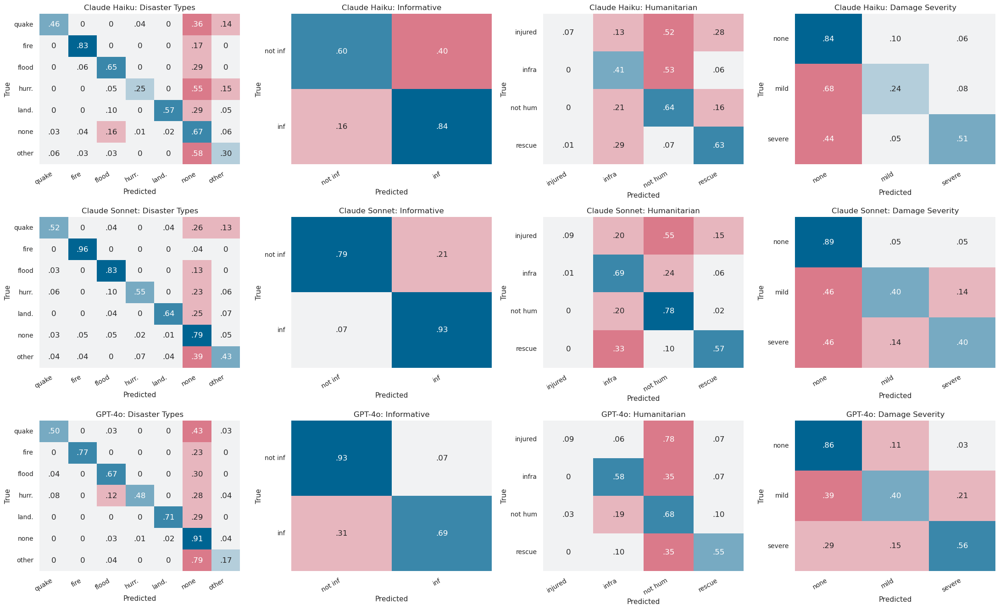

In [25]:
from src.augmentation.synthetic_tests import plot_confusion_matrices


plot_confusion_matrices(
    csv="../../src/augmentation/model_comparison_outputs/full_evaluation_results.csv",
    llm_models=[
        "claude-3-5-haiku-20241022",
        "claude-3-7-sonnet-20250219",
        "gpt-4o-2024-08-06",
    ],
    diffusion_model="bfai",
    prompt_key="caption_multistage",
)

**Cell 9** calls `generate_all_captions` to create a full set of textual captions (both real-image-based and hypothetical) for all label combinations. It uses our final chosen prompts and writes the LLM outputs to a CSV.


In [2]:
from src.augmentation.prompt_generation import generate_all_captions

generate_all_captions(
    prompts_file=config.AUGMENTATION_PROMPTS_FILE,
    real_prompt_key="real",  # Use your new prompt key
    hypo_prompt_key="hypothetical",
    fallback_keys=["fallback_1", "fallback_2"],
    llm_name=config.ANTHROPIC_MODEL,
    proportion_real=0.75,
    alloc_csv="../../src/augmentation/synthetic_image_allocations.csv",
    out_csv="../../src/augmentation/final_captions.csv",  # Different output file for testing
    verbose=True,
    max_workers=8,
    max_rows=None,  # Only process X rows for testing
    overwrite_output=True,
)

/home/evammun/anaconda3/envs/Thesis/lib/python3.12/site-packages/nvidia/dali/backend.py:53: Warning: DALI support for Python 3.12 is experimental and some functionalities may not work.
  deprecation_warning(


Processing 101 combos with 8 processes.
Results => ../../src/augmentation/final_captions.csv


Generating combos: 100%|██████████| 101/101 [4:15:27<00:00, 151.76s/it] 


Finished all combos.
Successes: 9956, Failures: 32
Success rate: 99.7%
Wrote final results to ../../src/augmentation/final_captions.csv


**Cell 10** uses a multiprocessing approach (`generate_images_with_black_forest_multiprocess`) to generate images in parallel from the final captions. This is particularly useful if there are thousands of images to generate. It logs errors to `bfai_errors_final.csv`.


In [ ]:
from src.augmentation.SD_image_generation import generate_images_with_black_forest

generate_images_with_black_forest(
    csv_in="../../src/augmentation/final_captions.csv",
    csv_out="../../src/augmentation/model_comparison_outputs/final_synthetic_set.csv",
    height=512,  # Must be multiple of 32
    width=512,  # Must be multiple of 32
    steps=30,
    guidance=2.5,
    safety_tolerance=5,  # Higher value = more permissive
    seed=config.SEED,
    output_format="png",
    error_log_csv="bfai_errors.csv",
    fallback_prompt="enable",
)

Reading input CSV file: ../../src/augmentation/final_captions.csv
Successfully read 9988 rows from input CSV
Found 9988 rows to process in parallel with 8 processes.


Processing chunks:   0%|          | 0/8 [00:00<?, ?it/s]

**Cell 11** (like Cell 7) is another optional block to re-run the evaluation logic (`evaluate_synthetic_images`) for the final synthetic dataset, writing out both results and failure statistics. If `REEVALUATE_SYNTHETIC = True`, the code executes.


In [4]:
REEVALUATE_SYNTHETIC = True


if REEVALUATE_SYNTHETIC:

    from src.augmentation.synthetic_tests import evaluate_final_synthetic_images

    results_path, fail_path = evaluate_final_synthetic_images(
        final_csv_path="../../src/augmentation/model_comparison_outputs/final_synthetic_set.csv",
        diffusion_model="bfai",
        sample_size=500,
        proportion_real=0.5,  # 50% real, 50% hypothetical
        output_dir="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs",
        head_only=None,  # Process only first X rows for testing
    )

Loading data from: ../../src/augmentation/model_comparison_outputs/final_synthetic_set.csv
Successfully loaded file with auto-detected delimiter: 9988 rows
Sampled 500 images:
  Real: 250 (50.0%)
  Hypothetical: 250 (50.0%)


Evaluating bfai: 100%|██████████| 500/500 [1:28:35<00:00, 10.63s/it]

Saved results: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/final_evaluation_results.csv
Saved failure stats: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/final_evaluation_failure_stats.csv


In [5]:
from src.augmentation.synthetic_tests import analyze_final_synthetic_results


analyze_final_synthetic_results(results_path, fail_path)

Analyzing results from: /home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/final_evaluation_results.csv
Loaded results with 500 rows
Non-missing images: 493



Source Type Distribution:
  hypothetical: 247 images (50.1%)
  real: 246 images (49.9%)

Error Counts:
  Claude Errors:
    JSONParseError: 4


In [ ]:
from src.augmentation.synthetic_tests import create_synthetic_test_audit

create_synthetic_test_audit(
    "../../src/augmentation/model_comparison_outputs/final_synthetic_set.csv",  # Pass the path as a string
    max_examples_real=1,
    max_examples_hypo=1,
)

Reading CSV from: ../../src/augmentation/model_comparison_outputs/final_synthetic_set.csv
Loaded 9988 rows with auto-detection


In [ ]:
from src.augmentation.SD_image_generation import create_augmented_training_file

create_augmented_training_file(
    relabelled_train_tsv="/home/evammun/Thesis/Dataset/MEDIC_train_relabelled.tsv",
    synthetic_csv="/home/evammun/Thesis/WSLcode/src/augmentation/model_comparison_outputs/final_synthetic_set.csv",
    augmented_tsv="/home/evammun/Thesis/Dataset/MEDIC_train_augmented.tsv",
    dataset_prefix_to_strip="/home/evammun/Thesis/Dataset/",
)

Found 9880 synthetic rows that are is_failure='False' and aug_img_path != 'CONTENT_REFUSAL'.
Augmented file created with 59233 total rows:
  Original relabelled: 49353
  Synthetic added: 9880
Saved to: /home/evammun/Thesis/Dataset/MEDIC_train_augmented.tsv


In [ ]:
from src.augmentation.synthetic_tests import analyze_final_synthetic_results

results_path = (
    "../../src/augmentation/model_comparison_outputs/final_evaluation_results.csv"
)
fail_path = (
    "../../src/augmentation/model_comparison_outputs/final_evaluation_failure_stats.csv"
)

analyze_final_synthetic_results(results_path, fail_path)

Analyzing results from: ../../src/augmentation/model_comparison_outputs/final_evaluation_results.csv
Loaded results with 500 rows
Non-missing images: 493



Source Type Distribution:
  hypothetical: 247 images (50.1%)
  real: 246 images (49.9%)

Error Counts:
  Claude Errors:
    JSONParseError: 4


Loaded 500 rows from ../../src/augmentation/model_comparison_outputs/final_evaluation_results.csv


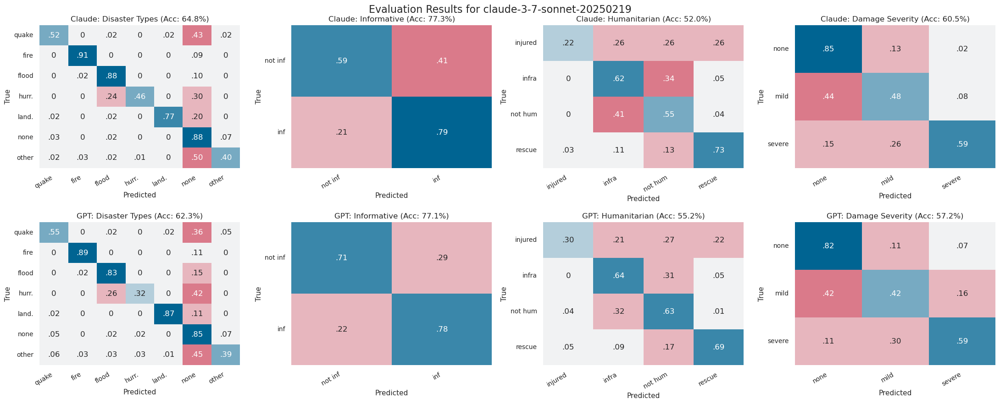

In [13]:
from src.augmentation.synthetic_tests import plot_final_confusion_matrices


plot_final_confusion_matrices(
    csv="../../src/augmentation/model_comparison_outputs/final_evaluation_results.csv"
)

Loading data from ../../src/augmentation/model_comparison_outputs/final_evaluation_results.csv
Found 493 valid images after filtering out missing ones
Processing 3 classes for task 'damage_severity'

Processing damage_severity - little_or_none
  Found 71 correct real, 36 correct hypothetical
  Found 5 incorrect real, 12 incorrect hypothetical


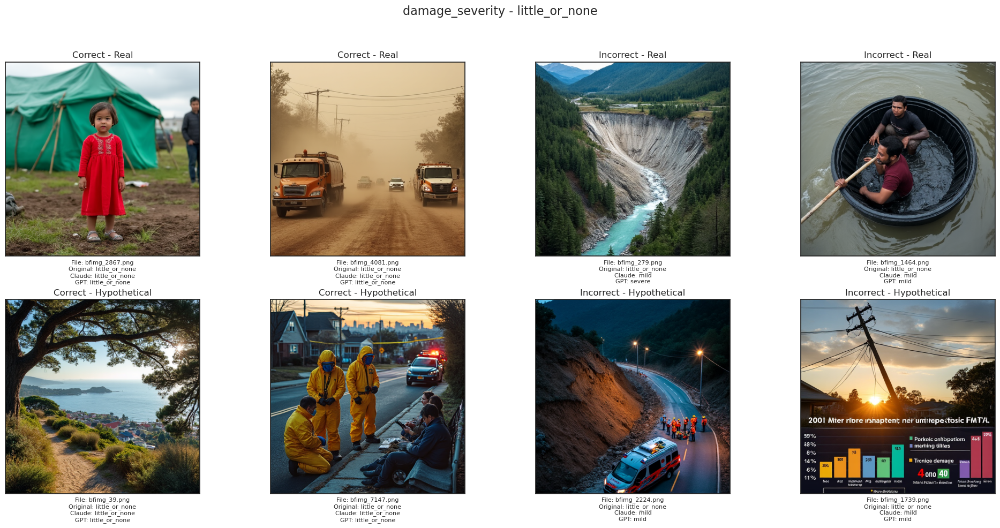


Processing damage_severity - severe
  Found 38 correct real, 23 correct hypothetical
  Found 24 incorrect real, 15 incorrect hypothetical


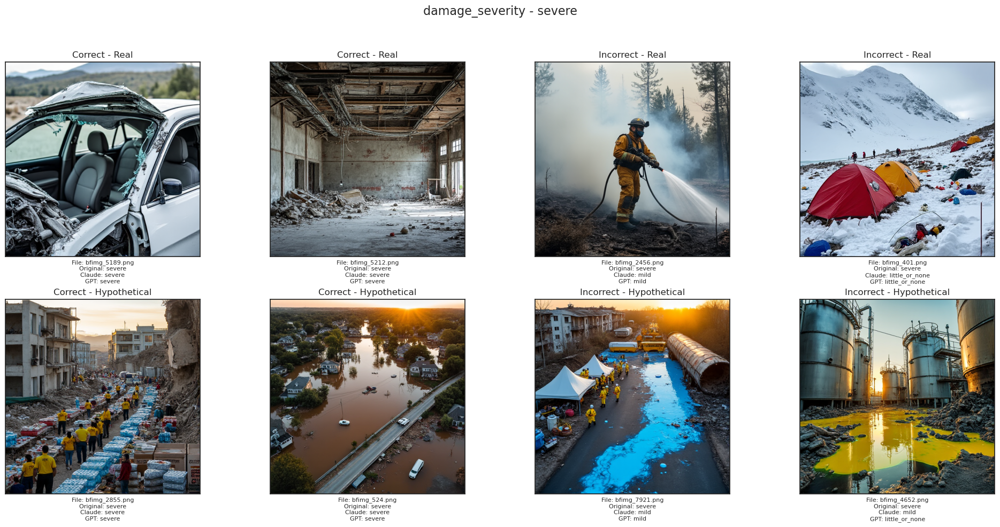


Processing damage_severity - mild
  Found 35 correct real, 45 correct hypothetical
  Found 35 incorrect real, 68 incorrect hypothetical


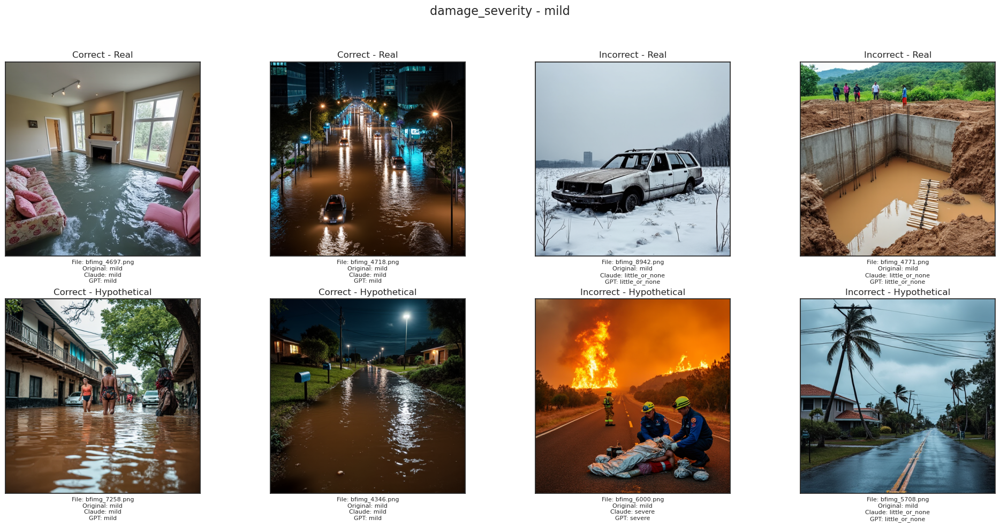

Processing 2 classes for task 'informative'

Processing informative - informative
  Found 169 correct real, 155 correct hypothetical
  Found 35 incorrect real, 32 incorrect hypothetical


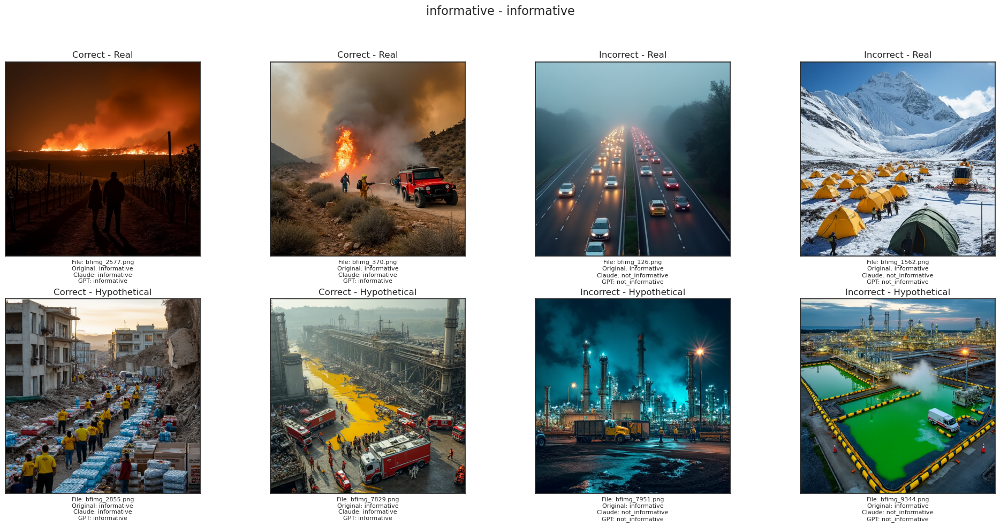


Processing informative - not_informative
  Found 4 correct real, 17 correct hypothetical
  Found 1 incorrect real, 8 incorrect hypothetical


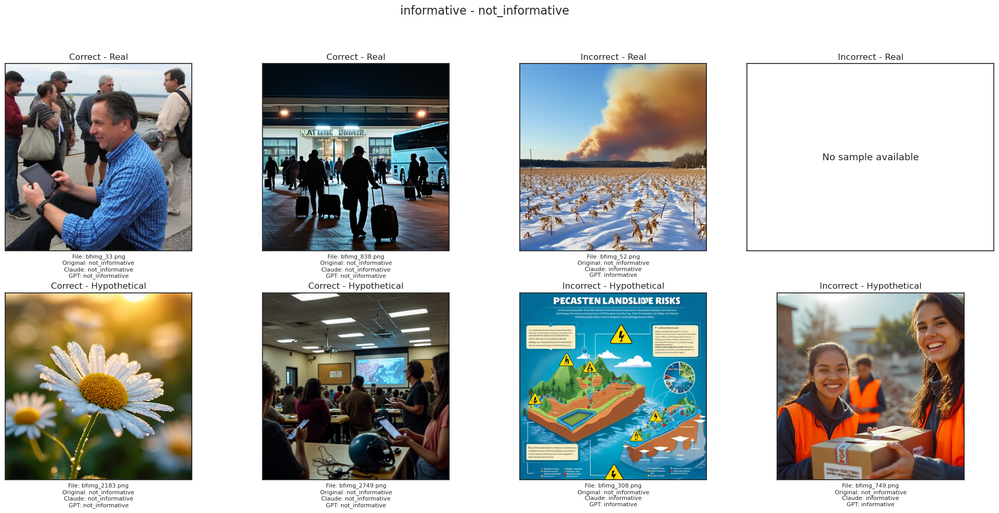

Processing 4 classes for task 'humanitarian'

Processing humanitarian - not_humanitarian
  Found 12 correct real, 29 correct hypothetical
  Found 6 incorrect real, 19 incorrect hypothetical


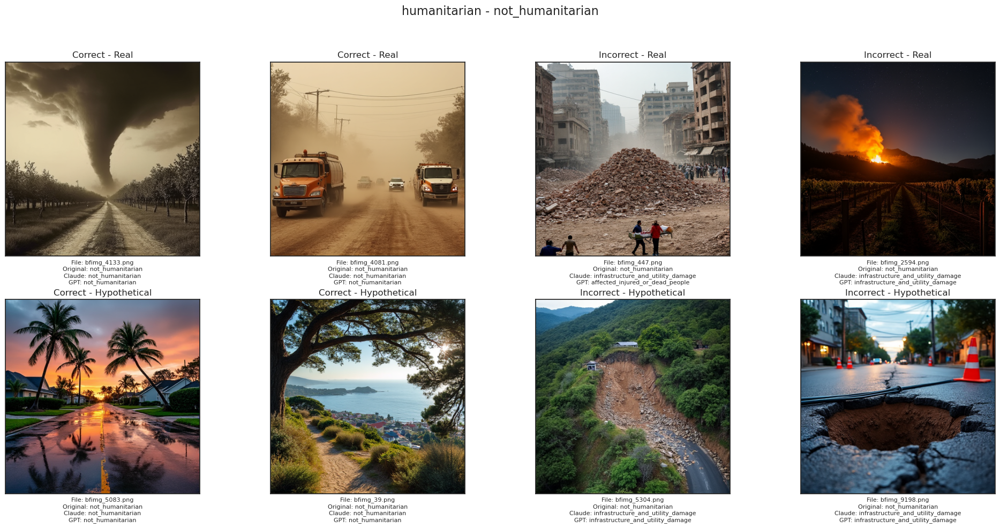


Processing humanitarian - infrastructure_and_utility_damage
  Found 42 correct real, 16 correct hypothetical
  Found 23 incorrect real, 7 incorrect hypothetical


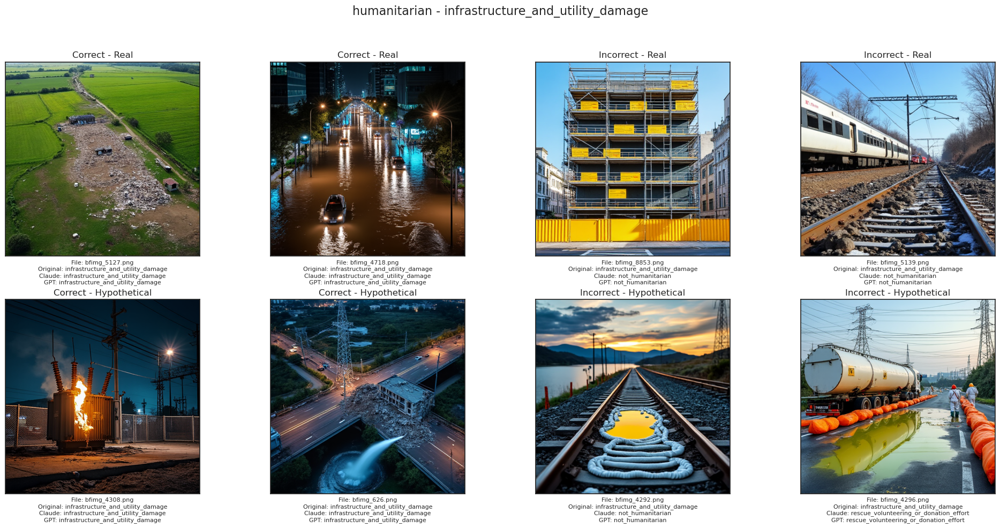


Processing humanitarian - affected_injured_or_dead_people
  Found 23 correct real, 3 correct hypothetical
  Found 21 incorrect real, 76 incorrect hypothetical


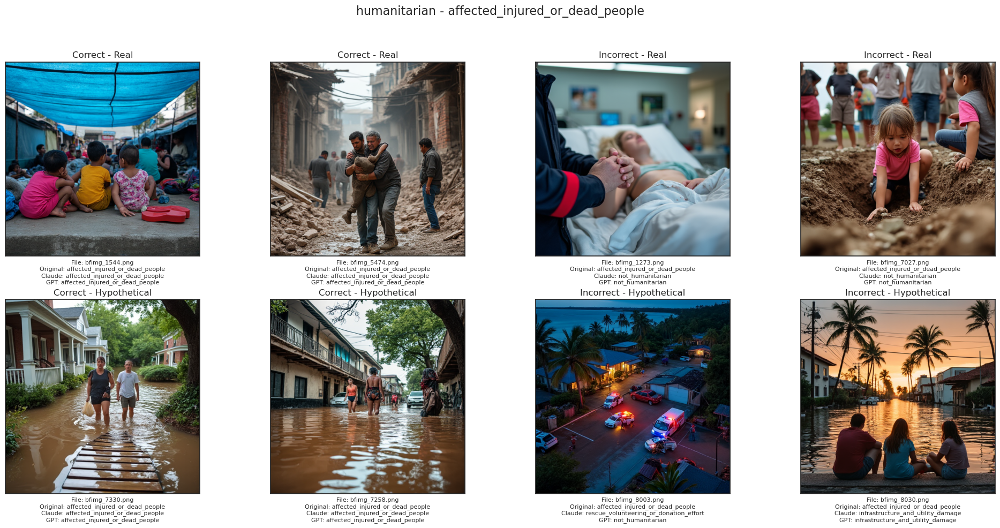


Processing humanitarian - rescue_volunteering_or_donation_effort
  Found 49 correct real, 49 correct hypothetical
  Found 19 incorrect real, 15 incorrect hypothetical


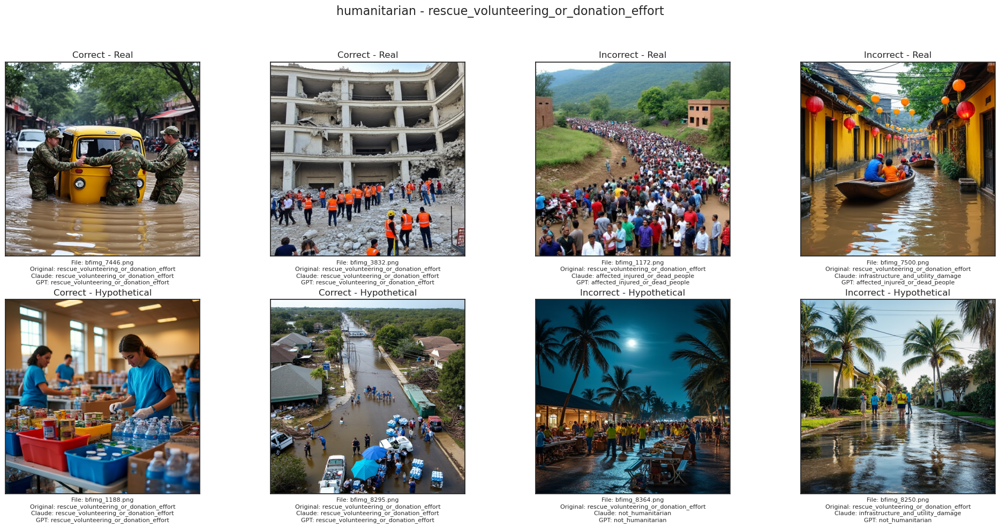

Processing 7 classes for task 'disaster_types'

Processing disaster_types - other_disaster
  Found 11 correct real, 25 correct hypothetical
  Found 38 incorrect real, 23 incorrect hypothetical


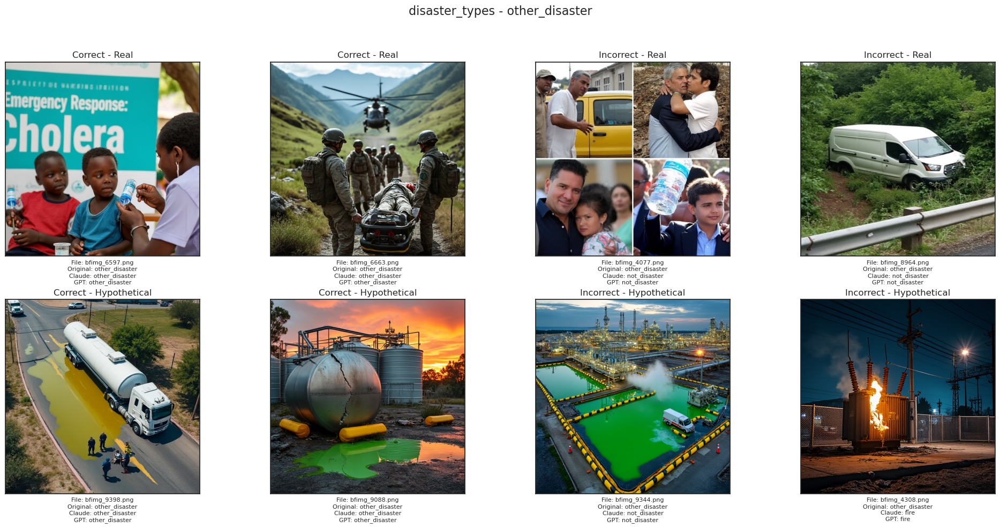


Processing disaster_types - landslide
  Found 19 correct real, 28 correct hypothetical
  Found 3 incorrect real, 4 incorrect hypothetical


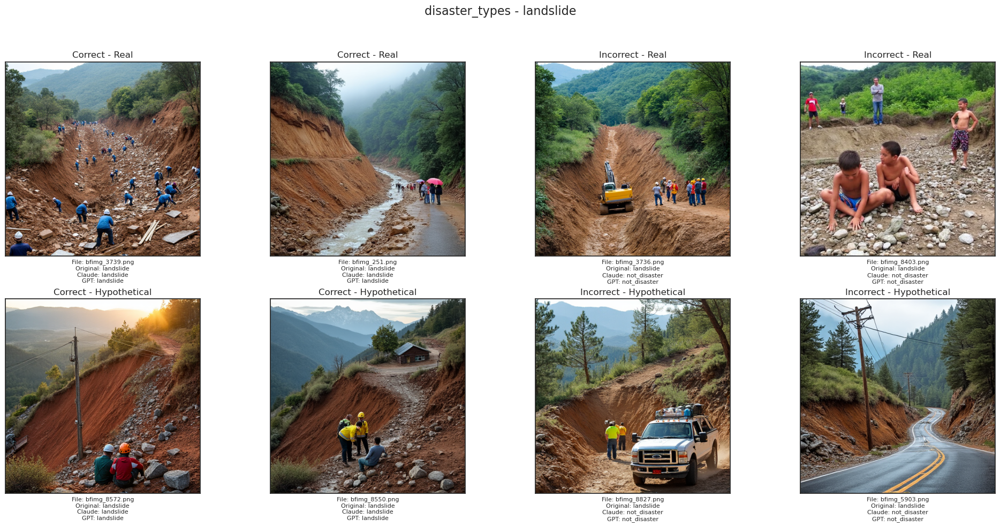


Processing disaster_types - earthquake
  Found 17 correct real, 7 correct hypothetical
  Found 14 incorrect real, 6 incorrect hypothetical


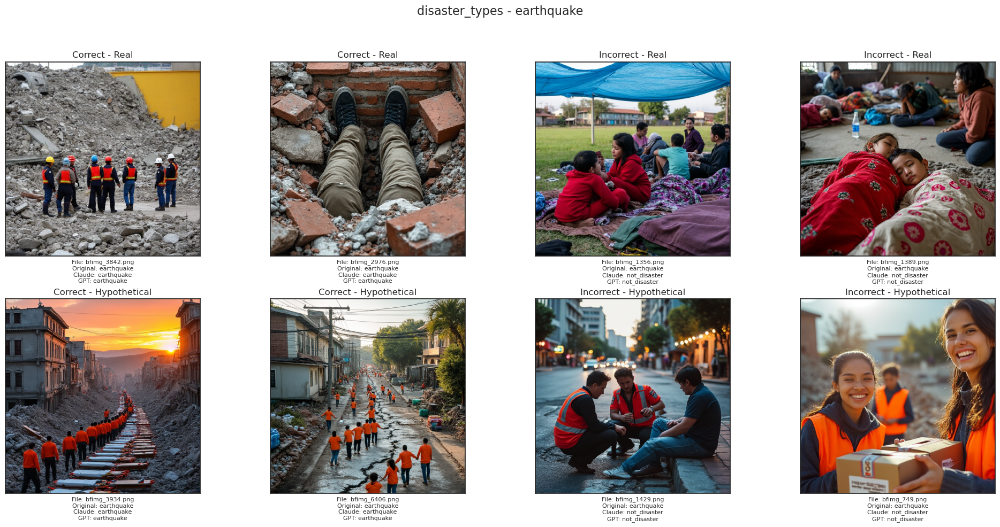


Processing disaster_types - not_disaster
  Found 17 correct real, 33 correct hypothetical
  Found 0 incorrect real, 6 incorrect hypothetical


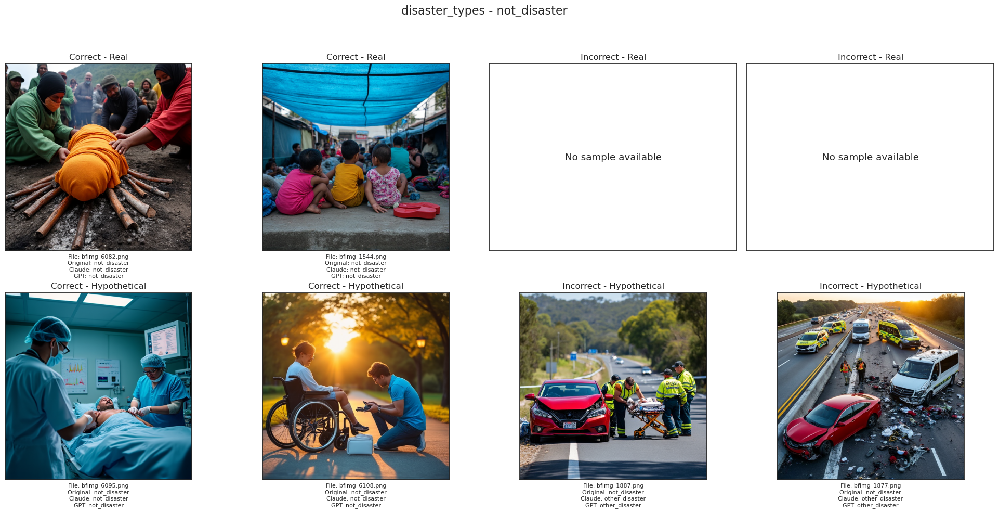


Processing disaster_types - flood
  Found 33 correct real, 17 correct hypothetical
  Found 6 incorrect real, 1 incorrect hypothetical


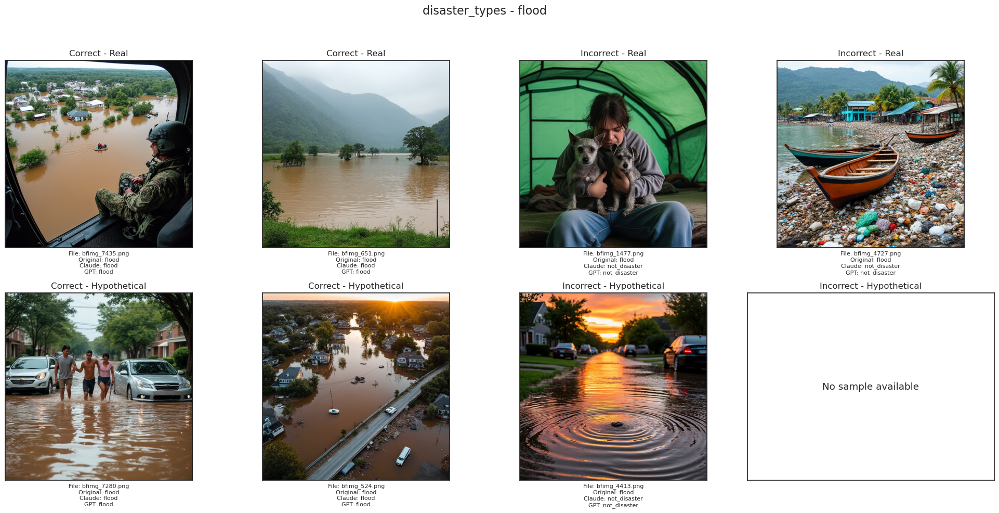


Processing disaster_types - fire
  Found 27 correct real, 23 correct hypothetical
  Found 2 incorrect real, 2 incorrect hypothetical


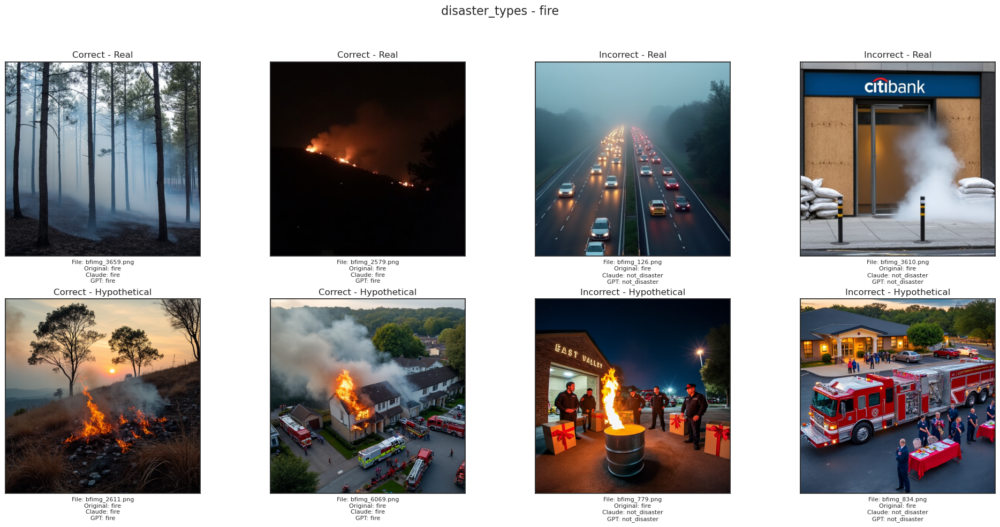


Processing disaster_types - hurricane
  Found 11 correct real, 9 correct hypothetical
  Found 16 incorrect real, 21 incorrect hypothetical


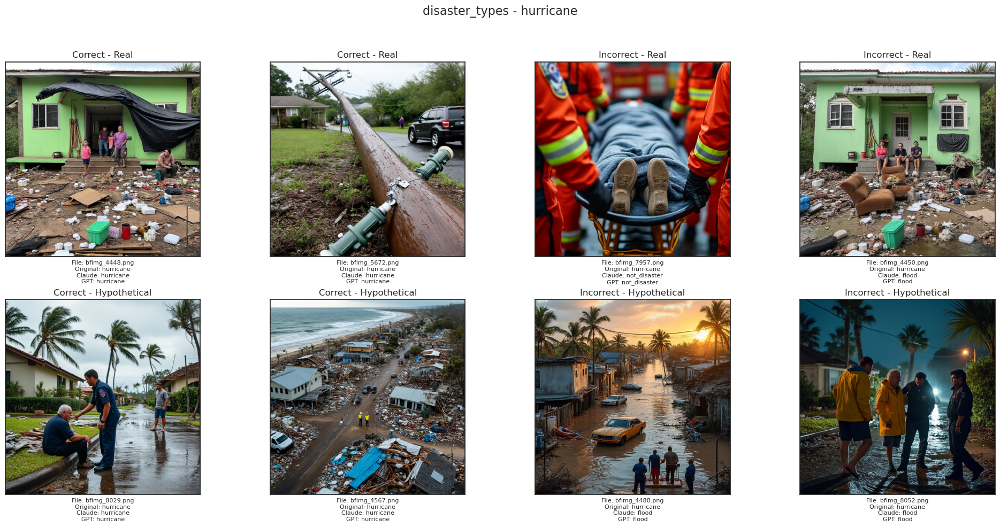

In [34]:
from src.augmentation.synthetic_tests import synthetic_image_samples

synthetic_image_samples(results_path)